<a href="https://colab.research.google.com/github/alejandrolq/ProyectoFinalStaticalLearningI/blob/main/Proyecto_SL.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

**Nombre: José Alejandro López Quel**

**Carné: 21001127**

**Statical Learning I**

**Sección U**

**Proyecto Final**

# Parte I: Entrenamiento, selección y validación.

## Importando librerías necesarias

In [1]:
import scipy
import datetime
import numpy as np
import pandas as pd
import seaborn as sns
import tensorflow as tf
import matplotlib.pyplot as plt
from joblib import dump
from sklearn import svm
from itertools import combinations
from sklearn.tree import DecisionTreeClassifier
from sklearn.linear_model import LinearRegression
from sklearn.model_selection import train_test_split
from sklearn.metrics import precision_recall_fscore_support
from sklearn.preprocessing import OneHotEncoder, normalize, scale
from sklearn.metrics import recall_score, f1_score, mean_squared_error, accuracy_score, precision_score

## Habilitando compatibilidad con TF1



In [2]:
if tf.__version__.startswith("2."):
  import tensorflow.compat.v1 as tf
  tf.compat.v1.disable_v2_behavior()
  tf.compat.v1.disable_eager_execution()
  print("Enabled compatitility to tf1.x")

Instructions for updating:
non-resource variables are not supported in the long term
Enabled compatitility to tf1.x


## Análisis exploratorio de dataset

### Importando datos

In [3]:
df = pd.read_csv("data_titanic_proyecto.csv")

### Visualizando datos importados

In [4]:
df.head()

,PassengerId,Name,Age,SibSp,Parch,Ticket,Fare,Cabin,Embarked,passenger_class,passenger_sex,passenger_survived
0,1,"Braund, Mr. Owen Harris",22.0,1,0,A/5 21171,7.2500,NaN,S,Lower,M,N
1,2,"Cumings, Mrs. John Bradley (Florence Briggs Th...",38.0,1,0,PC 17599,71.2833,C85,C,Upper,F,Y
2,3,"Heikkinen, Miss. Laina",26.0,0,0,STON/O2. 3101282,7.9250,NaN,S,Lower,F,Y
3,4,"Futrelle, Mrs. Jacques Heath (Lily May Peel)",35.0,1,0,113803,53.1000,C123,S,Upper,F,Y
4,5,"Allen, Mr. William Henry",35.0,0,0,373450,8.0500,NaN,S,Lower,M,N


In [10]:
df.describe()

,PassengerId,Age,SibSp,Parch,Fare
count,891.000000,714.000000,891.000000,891.000000,891.000000
mean,446.000000,29.699118,0.523008,0.381594,32.204208
std,257.353842,14.526497,1.102743,0.806057,49.693429
min,1.000000,0.420000,0.000000,0.000000,0.000000
25%,223.500000,20.125000,0.000000,0.000000,7.910400
50%,446.000000,28.000000,0.000000,0.000000,14.454200
75%,668.500000,38.000000,1.000000,0.000000,31.000000
max,891.000000,80.000000,8.000000,6.000000,512.329200


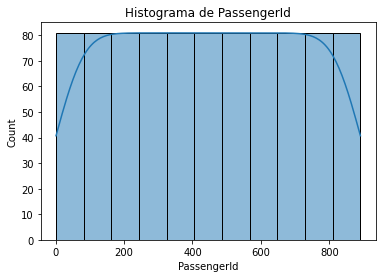

<Figure size 432x288 with 0 Axes>

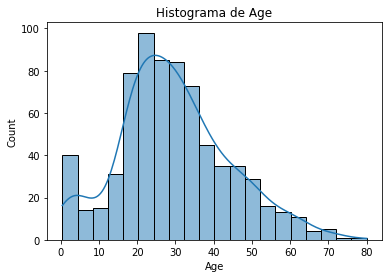

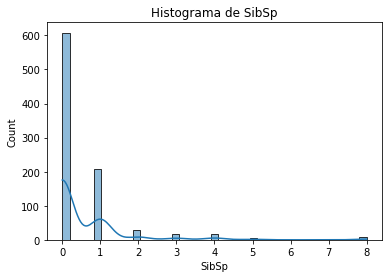

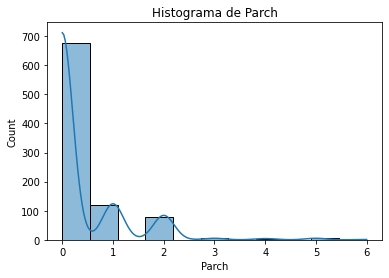

<Figure size 432x288 with 0 Axes>

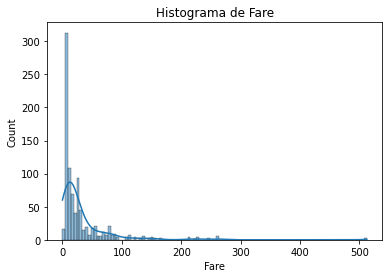

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

In [11]:
# Ciclo para imprimir los histogramas de cada variable númerica
for x in df.columns:
    plt.figure()
    # Se utiliza histplot en lugar de la función distplot debido a que ya esta marcada como deprecated
    if df[x].dtypes != 'object':
      sns.histplot(df[x],  kde=True).set_title("Histograma de "+ x)

In [12]:
df.isnull().sum()

PassengerId             0
Name                    0
Age                   177
SibSp                   0
Parch                   0
Ticket                  0
Fare                    0
Cabin                 687
Embarked                2
passenger_class         0
passenger_sex           0
passenger_survived      0
dtype: int64

In [13]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 891 entries, 0 to 890
Data columns (total 12 columns):
 #   Column              Non-Null Count  Dtype  
---  ------              --------------  -----  
 0   PassengerId         891 non-null    int64  
 1   Name                891 non-null    object 
 2   Age                 714 non-null    float64
 3   SibSp               891 non-null    int64  
 4   Parch               891 non-null    int64  
 5   Ticket              891 non-null    object 
 6   Fare                891 non-null    float64
 7   Cabin               204 non-null    object 
 8   Embarked            889 non-null    object 
 9   passenger_class     891 non-null    object 
 10  passenger_sex       891 non-null    object 
 11  passenger_survived  891 non-null    object 
dtypes: float64(2), int64(3), object(7)
memory usage: 83.7+ KB


### Feature engineering

#### Imputando datos

Se tiene que las columnas **Age**, **Cabin** y **Embarked** poseen datos NAN. Se obtiene que **Cabin** posee mas del 50% de sus datos con valores NAN, por lo que se procede a descartar la variable. Para las columnas **Age** y **Embarked** se procede a completar los datos con la media y la moda respectivamente.

In [5]:
df['Age'] = df['Age'].fillna(int(df['Age'].mean()))
df['Embarked'] = df['Embarked'].fillna(df['Embarked'].mode().iloc[0])

In [6]:
print(df['Age'].isnull().sum())
print(df['Embarked'].isnull().sum())

0
0


#### Sustituyendo valores categoricos por valores númericos

Se procede a sustituir los valores de las columnas **passenger_survived** y **passenger_sex** por los valores binarios (0 y 1), ya que solo poseen dos opciones para cada caso.

In [7]:
# Reemplazando columnas por valores binarios

# Para el caso de passenger_survived se selecciona 1 como 'Y' y 0 como 'N'.
df['passenger_survived'] = df['passenger_survived'].replace('Y',1)
df['passenger_survived'] = df['passenger_survived'].replace('N',0)

# Para el caso de passenger_sex se selecciona 1 como 'M' y 0 como 'F'.
df['passenger_sex'] = df['passenger_sex'].replace('M',1)
df['passenger_sex'] = df['passenger_sex'].replace('F',0)

#### One-hot encoding

Se realiza OHE para las variables categoricas de **passenger_class** y **Embarked**

In [8]:
df.passenger_class.unique()

array(['Lower', 'Upper', 'Middle'], dtype=object)

In [9]:
enc_train = OneHotEncoder(categories='auto')
passenger_class_OHE = np.array(df['passenger_class']).reshape(-1,1)
enc_train.fit(passenger_class_OHE)
passenger_class_OHE = enc_train.transform(passenger_class_OHE).toarray()
df['passenger_class_Lower'], df['passenger_class_Middle'], df['passenger_class_Upper'] = [passenger_class_OHE.T[0], passenger_class_OHE.T[1], passenger_class_OHE.T[2]]

In [10]:
df.Embarked.unique()

array(['S', 'C', 'Q'], dtype=object)

In [11]:
enc_train = OneHotEncoder(categories='auto')
Embarked_OHE = np.array(df['Embarked']).reshape(-1,1)
enc_train.fit(Embarked_OHE)
Embarked_OHE = enc_train.transform(Embarked_OHE).toarray()
df['Embarked_C'], df['Embarked_Q'], df['Embarked_S'] = [Embarked_OHE.T[0], Embarked_OHE.T[1], Embarked_OHE.T[2]]

#### Campos creados a partir de las columnas existentes

Se tiene que el dataset posee las columnas de **Sibsp** y **Parch**, las cuales representan el número de hermanos/cónyuges y número padres/hijos abordo respectivamente. Por lo que apartir de estos datos se puede calcular el tamaño de la familia que iba abordo del barco.

In [12]:
# Creando nueva columna llamada family_size a partir de las columnas mencionadas
df['family_size'] = df['SibSp'] + df['Parch']

#### Normailización de los datos

Se procede a eliminar las columnas que no aportan al modelo y a normalizar los datos restantes

In [13]:
# Creando dataframe con columnas que aportan al modelo
df_clean = df.drop(columns = ['PassengerId', 'Name', 'Ticket', 'Cabin', 'Embarked', 'passenger_class'])
df_clean.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 891 entries, 0 to 890
Data columns (total 13 columns):
 #   Column                  Non-Null Count  Dtype  
---  ------                  --------------  -----  
 0   Age                     891 non-null    float64
 1   SibSp                   891 non-null    int64  
 2   Parch                   891 non-null    int64  
 3   Fare                    891 non-null    float64
 4   passenger_sex           891 non-null    int64  
 5   passenger_survived      891 non-null    int64  
 6   passenger_class_Lower   891 non-null    float64
 7   passenger_class_Middle  891 non-null    float64
 8   passenger_class_Upper   891 non-null    float64
 9   Embarked_C              891 non-null    float64
 10  Embarked_Q              891 non-null    float64
 11  Embarked_S              891 non-null    float64
 12  family_size             891 non-null    int64  
dtypes: float64(8), int64(5)
memory usage: 90.6 KB


In [14]:
# Normalizando datos
df_clean[['Age', 'SibSp', 'Parch', 'Fare', 'family_size']] = normalize(df_clean[['Age', 'SibSp', 'Parch', 'Fare', 'family_size']])
df_clean[['Age', 'SibSp', 'Parch', 'Fare', 'family_size']].head(5)

,Age,SibSp,Parch,Fare,family_size
0,0.947992,0.043091,0.0,0.312406,0.043091
1,0.470345,0.012377,0.0,0.882309,0.012377
2,0.956551,0.000000,0.0,0.291564,0.000000
3,0.550202,0.015720,0.0,0.834735,0.015720
4,0.974555,0.000000,0.0,0.224148,0.000000


#### Visualizando datos despues del feature engineering

In [15]:
df_clean.head(5)

,Age,SibSp,Parch,Fare,passenger_sex,passenger_survived,passenger_class_Lower,passenger_class_Middle,passenger_class_Upper,Embarked_C,Embarked_Q,Embarked_S,family_size
0,0.947992,0.043091,0.0,0.312406,1,0,1.0,0.0,0.0,0.0,0.0,1.0,0.043091
1,0.470345,0.012377,0.0,0.882309,0,1,0.0,0.0,1.0,1.0,0.0,0.0,0.012377
2,0.956551,0.000000,0.0,0.291564,0,1,1.0,0.0,0.0,0.0,0.0,1.0,0.000000
3,0.550202,0.015720,0.0,0.834735,0,1,0.0,0.0,1.0,0.0,0.0,1.0,0.015720
4,0.974555,0.000000,0.0,0.224148,1,0,1.0,0.0,0.0,0.0,0.0,1.0,0.000000


### Separación de datos para entrenamiento, validación y pruebas

In [16]:
# Seleccionando variables independientes (x) y variable dependiente (y)
x = df_clean.drop(columns = ['passenger_survived'])
y = df_clean['passenger_survived']

In [17]:
# Separando los datos de entrenamiento y prueba con una proporción de 80% y 20% respectivamente
x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.20,random_state=1824)

In [18]:
# Separando los datos de entrenamiento y validación con una proporción de 80% y 20% respectivamente
x_train, x_val, y_train, y_val = train_test_split(x_train, y_train, test_size=0.20,random_state=1824)

In [19]:
# Comprobando dimensiones de los sets extraidos
print("Tamaño set de entrenamiento: \t", x_train.shape)
print("Tamaño set de validación: \t", x_val.shape)
print("Tamaño set de prueba: \t\t", x_test.shape)

Tamaño set de entrenamiento: 	 (569, 12)
Tamaño set de validación: 	 (143, 12)
Tamaño set de prueba: 		 (179, 12)


### Exportando datos para deployment

In [20]:
dump(x_test, 'x_test_deploy.joblib')

['x_test_deploy.joblib']

In [21]:
dump(y_test, 'y_test_deploy.joblib')

['y_test_deploy.joblib']

## Ensemble learning

In [97]:
def metricas_evaluacion(y, predicciones):
  accuracy_val = accuracy_score(y, predicciones)
  error_val = mean_squared_error(y, predicciones)
  precision_val = precision_score(y, predicciones)
  recall_val = recall_score(y, predicciones)
  f1_score_val = f1_score(y, predicciones)
  return accuracy_val, error_val, precision_val, recall_val, f1_score_val

### Árbol de decisión con sklearn

In [78]:
# Creando modelo empleando un árbol de decisión
def train_DT(max_depth, min_samples_split, min_samples_leaf, x_train, y_train, x_val, y_val, get_model):
  model_string = 'max_depth={}_min_samples_split={}_min_samples_leaf={}'.format(max_depth, min_samples_split, min_samples_leaf)
  model = DecisionTreeClassifier(max_depth = max_depth, min_samples_split = min_samples_split, min_samples_leaf = min_samples_leaf)
  model.fit(x_train, y_train)
  predicciones_val = model.predict(x_val)
  metricas = metricas_evaluacion(y_val, predicciones_val)
  if get_model:
    return model
  return model_string, metricas

In [138]:
# Prueba de los datos de la función de entrenamiento
train_DT(10, 2, 1, x_train, y_train, x_val, y_val, False)

('max_depth=10_min_samples_split=2_min_samples_leaf=1',
 (0.7902097902097902,
  0.2097902097902098,
  0.7735016420361247,
  0.7815934065934066,
  0.7768414481897629))

In [141]:
# Entrenamiento y selección del mejor modelo 
fname = 'test_DT.csv'
experiment = []
accuracy_val = []
error_val = []
precision_val = []
recall_val = []
f1_score_val = []

for msl in range(1, 10):
  for mss in range(2,10):
    for md in range(1, 10):
      experimento = train_DT(md, mss, msl, x_train, y_train, x_val, y_val, False)
      experiment.append(experimento[0])
      accuracy_val.append(experimento[1][0])
      error_val.append(experimento[1][1])
      precision_val.append(experimento[1][2])
      recall_val.append(experimento[1][3])
      f1_score_val.append(experimento[1][4])

experimentos = {'experiment': experiment, 'accuracy_val': accuracy_val, 
                'error_val': error_val, 'precision_val': precision_val, 
                'recall_val': recall_val, 'f1_score_val': f1_score_val}

df = pd.DataFrame(experimentos)
df.to_csv(fname, mode='a', header=False, index=False)
print('Total de experimentos: ' + str(len(df)))
df.sort_values(by=['accuracy_val'], ascending=False)

Total de experimentos: 648


,experiment,accuracy_val,error_val,precision_val,recall_val,f1_score_val
185,max_depth=6_min_samples_split=6_min_samples_le...,0.846154,0.153846,0.837829,0.825549,0.830860
158,max_depth=6_min_samples_split=3_min_samples_le...,0.846154,0.153846,0.837829,0.825549,0.830860
215,max_depth=9_min_samples_split=9_min_samples_le...,0.839161,0.160839,0.838605,0.807692,0.818738
104,max_depth=6_min_samples_split=5_min_samples_le...,0.839161,0.160839,0.831339,0.815934,0.822341
462,max_depth=4_min_samples_split=5_min_samples_le...,0.839161,0.160839,0.831339,0.815934,0.822341
...,...,...,...,...,...,...
17,max_depth=9_min_samples_split=3_min_samples_le...,0.797203,0.202797,0.782241,0.774725,0.778057
26,max_depth=9_min_samples_split=4_min_samples_le...,0.797203,0.202797,0.781223,0.778846,0.779988
79,max_depth=8_min_samples_split=2_min_samples_le...,0.797203,0.202797,0.785941,0.766484,0.773796
106,max_depth=8_min_samples_split=5_min_samples_le...,0.790210,0.209790,0.776782,0.760989,0.767152


In [142]:
# Se selecciona el experimento con mayor accuracy
df.sort_values(by=['accuracy_val'], ascending=False)['experiment'][185]

'max_depth=6_min_samples_split=6_min_samples_leaf=3'

In [143]:
# Obteniendo el modelo
modelo_DT = train_DT(6, 6, 3, x_train, y_train, x_val, y_val, True)
print(modelo_DT)

DecisionTreeClassifier(ccp_alpha=0.0, class_weight=None, criterion='gini',
                       max_depth=6, max_features=None, max_leaf_nodes=None,
                       min_impurity_decrease=0.0, min_impurity_split=None,
                       min_samples_leaf=3, min_samples_split=6,
                       min_weight_fraction_leaf=0.0, presort='deprecated',
                       random_state=None, splitter='best')


In [144]:
# Exportando modelo
dump(modelo_DT, "max_depth=6_min_samples_split=6_min_samples_leaf=3.joblib")

['max_depth=6_min_samples_split=6_min_samples_leaf=3.joblib']

### SVM con sklearn

In [79]:
# Creando modelo empleando Support Vector Machine
def train_SVM(C, kernel, x_train, y_train, x_val, y_val, get_model):
  model_string = 'C={}_kernel={}'.format(C, kernel)
  model = svm.SVC(C=C, kernel=kernel)
  model.fit(x_train, y_train)
  predicciones_val = model.predict(x_val)
  metricas = metricas_evaluacion(y_val, predicciones_val)
  if get_model:
    return model
  return model_string, metricas

In [151]:
# Prueba de los datos de la función de entrenamiento
train_SVM(1, 'rbf', x_train, y_train, x_val, y_val, False)

('C=1_kernel=rbf',
 (0.8321678321678322,
  0.16783216783216784,
  0.8376213592233009,
  0.793956043956044,
  0.8077095472882116))

In [155]:
# Entrenamiento y selección del mejor modelo 
fname = 'test_SVM.csv'
experiment = []
accuracy_val = []
error_val = []
precision_val = []
recall_val = []
f1_score_val = []

methods = ['linear', 'poly', 'rbf', 'sigmoid']

for m in methods:
  for C in range(1, 100):
    experimento = train_SVM(C, m, x_train, y_train, x_val, y_val, False)
    experiment.append(experimento[0])
    accuracy_val.append(experimento[1][0])
    error_val.append(experimento[1][1])
    precision_val.append(experimento[1][2])
    recall_val.append(experimento[1][3])
    f1_score_val.append(experimento[1][4])

experimentos = {'experiment': experiment, 'accuracy_val': accuracy_val, 
                'error_val': error_val, 'precision_val': precision_val, 
                'recall_val': recall_val, 'f1_score_val': f1_score_val}

df = pd.DataFrame(experimentos)
df.to_csv(fname, mode='a', header=False, index=False)
print('Total de experimentos: ' + str(len(df)))
df.sort_values(by=['accuracy_val'], ascending=False)

Total de experimentos: 396


,experiment,accuracy_val,error_val,precision_val,recall_val,f1_score_val
106,C=8_kernel=poly,0.846154,0.153846,0.849364,0.813187,0.825687
105,C=7_kernel=poly,0.846154,0.153846,0.849364,0.813187,0.825687
104,C=6_kernel=poly,0.846154,0.153846,0.849364,0.813187,0.825687
165,C=67_kernel=poly,0.839161,0.160839,0.831339,0.815934,0.822341
166,C=68_kernel=poly,0.839161,0.160839,0.831339,0.815934,0.822341
...,...,...,...,...,...,...
372,C=76_kernel=sigmoid,0.622378,0.377622,0.594673,0.596154,0.595283
373,C=77_kernel=sigmoid,0.622378,0.377622,0.594673,0.596154,0.595283
374,C=78_kernel=sigmoid,0.622378,0.377622,0.594673,0.596154,0.595283
375,C=79_kernel=sigmoid,0.622378,0.377622,0.594673,0.596154,0.595283


In [156]:
# Se selecciona el experimento con mayor accuracy
df.sort_values(by=['accuracy_val'], ascending=False)['experiment'][106]

'C=8_kernel=poly'

In [158]:
# Obteniendo el modelo
modelo_SVM = train_SVM(8, 'poly', x_train, y_train, x_val, y_val, True)
print(modelo_SVM)

SVC(C=8, break_ties=False, cache_size=200, class_weight=None, coef0=0.0,
    decision_function_shape='ovr', degree=3, gamma='scale', kernel='poly',
    max_iter=-1, probability=False, random_state=None, shrinking=True,
    tol=0.001, verbose=False)


In [159]:
# Exportando modelo
dump(modelo_SVM, "C=8_kernel=poly.joblib")

['C=8_kernel=poly.joblib']

### Naive bayes con numpy y pandas

In [80]:
class NaiveBayes:
  def fit(self, x, y):
    self._classes = np.unique(y)
    n_classes = len(self._classes)
    self._res = []
    self._prob = []
    for i, c in enumerate(self._classes):
      x_c = x[y == c]
      sd = np.array(np.std(x_c))
      mean = np.array(np.mean(x_c))
      self._res.append(np.stack((mean,sd), axis = 0).T)
      self._prob.append(x_c.shape[0]/x.shape[0])

  def predict(self, X):
    data = {}
    for i in range(len(self._res)):
      array = []
      for r in range(self._res[i].shape[0]):
        predicciones = scipy.stats.norm(self._res[i][r][0], self._res[i][r][1]).cdf(X.iloc[:, [r]])
        array.append(predicciones)
      data[i] = array
    y = []
    for key in data:
      array = data[key]
      prob = self._prob[key]
      array_predict = self._predict(array, prob)
      y.append(array_predict)
    y = np.concatenate(y, axis = 1)
    predictions = np.argmax(y, axis = 1)
    return predictions

  def _predict(self, array, prob):
    x_probabilities = np.array(array).T.squeeze()
    x = np.concatenate((x_probabilities, np.full_like(x_probabilities[:,0],prob).reshape(-1,1)), axis = 1)
    return np.prod(x, axis = 1).reshape(-1,1)

In [81]:
def train_NaiveBayes(x_train, y_train, x_val, y_val, get_model):
  m_string = ''
  for column in x_train.columns:
    m_string += '_{}'.format(column)
  model_string = 'NB_{}'.format(m_string)
  model = NaiveBayes()
  model.fit(x_train, y_train)
  predicciones_val = model.predict(x_val)
  metricas = metricas_evaluacion(y_val, predicciones_val)
  if get_model:
    return model
  return model_string, metricas

In [222]:
# Prueba de los datos de la función de entrenamiento
train_NaiveBayes(x_train, y_train, x_val, y_val, False)

('NB__Age_SibSp_Parch_Fare_passenger_sex_passenger_class_Lower_passenger_class_Middle_passenger_class_Upper_Embarked_C_Embarked_Q_Embarked_S_family_size',
 (0.7622377622377622,
  0.23776223776223776,
  0.7673325499412456,
  0.7884615384615384,
  0.7588293650793652))

In [242]:
# Entrenamiento y selección del mejor modelo 
fname = 'test_NB.csv'
experiment = []
accuracy_val = []
error_val = []
precision_val = []
recall_val = []
f1_score_val = []

for i in range(4, len(x_train.columns)):
  for column in list(combinations(x_train.columns,i)):
    experimento = train_NaiveBayes(x_train[list(column)], y_train, x_val[list(column)], y_val, False)
    experiment.append(experimento[0])
    accuracy_val.append(experimento[1][0])
    error_val.append(experimento[1][1])
    precision_val.append(experimento[1][2])
    recall_val.append(experimento[1][3])
    f1_score_val.append(experimento[1][4])

experimentos = {'experiment': experiment, 'accuracy_val': accuracy_val, 
                'error_val': error_val, 'precision_val': precision_val, 
                'recall_val': recall_val, 'f1_score_val': f1_score_val}

df = pd.DataFrame(experimentos)
df.to_csv(fname, mode='a', header=False, index=False)
print('Total de experimentos: ' + str(len(df)))
df.sort_values(by=['accuracy_val'], ascending=False)

/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Pr

Total de experimentos: 3796


,experiment,accuracy_val,error_val,precision_val,recall_val,f1_score_val
2693,NB__SibSp_Parch_Fare_passenger_sex_passenger_c...,0.839161,0.160839,0.831339,0.815934,0.822341
2021,NB__Parch_Fare_passenger_sex_passenger_class_M...,0.839161,0.160839,0.831339,0.815934,0.822341
3473,NB__Parch_Fare_passenger_sex_passenger_class_U...,0.839161,0.160839,0.831339,0.815934,0.822341
2909,NB__Parch_Fare_passenger_sex_passenger_class_M...,0.839161,0.160839,0.828810,0.820055,0.823976
1895,NB__SibSp_Fare_passenger_sex_passenger_class_M...,0.832168,0.167832,0.820108,0.814560,0.817136
...,...,...,...,...,...,...
2279,NB__Age_SibSp_Parch_passenger_sex_passenger_cl...,0.363636,0.636364,0.181818,0.500000,0.266667
1430,NB__Age_SibSp_passenger_sex_passenger_class_Lo...,0.363636,0.636364,0.181818,0.500000,0.266667
1439,NB__Age_SibSp_passenger_sex_passenger_class_Lo...,0.363636,0.636364,0.181818,0.500000,0.266667
1440,NB__Age_SibSp_passenger_sex_passenger_class_Lo...,0.363636,0.636364,0.430851,0.495879,0.275001


In [245]:
# Se selecciona el experimento con mayor accuracy
df.sort_values(by=['accuracy_val'], ascending=False)['experiment'][1895]

'NB__SibSp_Fare_passenger_sex_passenger_class_Middle_Embarked_C_Embarked_S'

In [247]:
# Obteniendo el modelo
columns = ['SibSp', 'Fare', 'passenger_sex', 'passenger_class_Middle', 'Embarked_C', 'Embarked_S']
modelo_NB = train_NaiveBayes(x_train[list(columns)], y_train, x_val[list(columns)], y_val, True)
print(modelo_NB)

In [248]:
# Exportando modelo
dump(modelo_NB, "NB__SibSp_Fare_passenger_sex_passenger_class_Middle_Embarked_C_Embarked_S.joblib")

['NB__SibSp_Fare_passenger_sex_passenger_class_Middle_Embarked_C_Embarked_S.joblib']

### Regresión logística binaria(sigmoid)

In [38]:
class LogisticRegressionSigmoid:
  def __init__(self, x, lambda_parameter, regularization):
    self.w = tf.get_variable("weights", dtype = tf.float32, shape = [1,x.shape[1]], initializer = tf.zeros_initializer())
    self.lambda_parameter = tf.constant(lambda_parameter, dtype = tf.float32)
    self.regularization = regularization
      
  def logits(self, x):
    return tf.matmul(x, tf.transpose(self.w))

  def prediction(self, x):
    sigmoid = tf.nn.sigmoid(self.logits(x))
    return tf.round(sigmoid)

  def accuracy(self, predicciones, y):
    accuracy = tf.equal(predicciones, y)
    accuracy = tf.dtypes.cast(accuracy, tf.int32)
    accuracy = tf.divide(tf.reduce_sum(accuracy), tf.shape(y)[0])
    return accuracy
  
  def loss(self, x, y):
    cross_entropy = tf.reduce_mean(tf.nn.sigmoid_cross_entropy_with_logits(labels = y, logits = self.logits(x)))
    if self.regularization == 'lasso':
        error = tf.add(cross_entropy,tf.multiply(self.lambda_parameter, tf.reduce_sum(tf.abs(self.w))))
    if self.regularization == 'ridge':
        error = tf.add(cross_entropy, tf.multiply(self.lambda_parameter, tf.sqrt(tf.reduce_sum(tf.square(self.w)))))
    return error
          
  def actualizar(self, x, y, learning_rate):
    with tf.name_scope("Error"):
      error = self.loss(x, y)
    with tf.name_scope("Accuracy"):
      accuracy = self.accuracy(self.prediction(x), y)
    gradientes = tf.gradients(error, [self.w])
    actualizacion_w = tf.assign(self.w, self.w - learning_rate * gradientes[0])
    return actualizacion_w, error, accuracy

In [47]:
def ejecutar_modelo_LRS(learning_rate, epochs, x, y, lambda_parameter, regularization, batch_size=32):
  tf.compat.v1.reset_default_graph()
  
  config_string = "lr={}_epochs={}_batch_size={}_lambda_parameter={}_regularization={}".format(learning_rate, epochs, batch_size, lambda_parameter, regularization)

  tf.compat.v1.reset_default_graph()
  X = np.insert(np.array(x),0, np.ones(len(x)), axis = 1)
  labels_ = np.array(y).reshape(-1,1)
  
  total_iteraciones = int(labels_.shape[0]/batch_size)

  modelo = LogisticRegressionSigmoid(X, lambda_parameter, regularization)

  tensor_x = tf.placeholder(tf.float32, [None, X.shape[1]], "tensor_x")
  tensor_labels = tf.placeholder(tf.float32, [None, labels_.shape[1]], "tensor_labels")

  actualizacion_parametros = modelo.actualizar(tensor_x, tensor_labels, learning_rate)

  with tf.train.MonitoredSession() as session:
    writer = tf.summary.FileWriter('tests/' + config_string, session.graph)
    for epoch in range(epochs):
      for i in range(total_iteraciones):
        muestra_inicio = i*batch_size
        muestra_fin = muestra_inicio + batch_size
        x_mb = X[muestra_inicio:muestra_fin,]
        y_mb = labels_[muestra_inicio:muestra_fin,]

        feed_dict = {tensor_x:x_mb, tensor_labels:y_mb}
        variables = session.run(actualizacion_parametros,feed_dict=feed_dict)

      error = tf.Summary(value=[tf.Summary.Value(tag="error", simple_value=variables[1])])
      accuracy = tf.Summary(value=[tf.Summary.Value(tag="accuracy", simple_value=variables[2])])
      writer.add_summary(error, epoch)
      writer.add_summary(accuracy, epoch)
  return variables[0]

In [48]:
test_w = ejecutar_modelo_LRS(0.01, 1000, x_train, y_train, 0, 'lasso')

INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.


In [60]:
def predict_LRS(x, weights):
  tf.reset_default_graph()

  X = np.insert(np.array(x),0, np.ones(len(x)), axis = 1)

  tensor_x = tf.placeholder(tf.float32, shape = [None, None], name = "tensor_x")
  tensor_w = tf.placeholder(tf.float32, shape = [None, None], name = "tensor_w")

  logits = tf.matmul(tensor_x, tf.transpose(tensor_w))
  sigmoid = tf.nn.sigmoid(logits)
  prediction = tf.round(sigmoid)

  with tf.train.MonitoredSession() as session:
    feed_dictionary = {tensor_x: X, tensor_w:weights}
    predictions = session.run(prediction, feed_dict= feed_dictionary)
    return predictions.T

In [65]:
print(predict_LRS(x_val, test_w))
print(y_val)
print(metricas_evaluacion(y_val, predict_LRS(x_val, test_w)[0]))

INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
[[0. 0. 0. 1. 0. 0. 1. 0. 0. 1. 0. 1. 1. 0. 0. 0. 1. 0. 1. 0. 1. 0. 1. 0.
  0. 0. 0. 0. 1. 1. 1. 0. 1. 0. 0. 0. 0. 1. 1. 1. 0. 0. 0. 0. 0. 0. 1. 0.
  1. 1. 1. 1. 0. 1. 0. 1. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 1. 1. 1. 1.
  1. 1. 0. 0. 0. 0. 0. 1. 1. 1. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0.
  0. 0. 0. 0. 1. 1. 0. 1. 1. 1. 1. 0. 0. 1. 0. 1. 1. 1. 0. 0. 1. 0. 0. 0.
  0. 1. 0. 1. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0.]]
538    0
162    0
848    0
84     1
714    0
      ..
252    0
351    0
531    0
709    1
273    0
Name: passenger_survived, Length: 143, dtype: int64
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
(0.8251748251748252, 0.17482517482517482, 0.8132870169344333, 0.804945054945055, 0.8086700561948086)


In [73]:
# Entrenamiento y selección del mejor modelo 
fname = 'test_LRS.csv'
experiment = []
accuracy_val = []
error_val = []
precision_val = []
recall_val = []
f1_score_val = []

lrs = [0.01, 0.001, 0.0001]
lambdas = [0, 0.1, 0.01]
epochs = [1000, 10000]
regularizations = ['lasso', 'ridge']
batch_sizes = [32, 100, 500]

for reg in regularizations:
  for lambda_ in lambdas:
    for lr in lrs:
      for batch_size in batch_sizes:
        for epoch in epochs:
          config_string = "lr={}_epochs={}_batch_size={}_lambda_parameter={}_regularization={}".format(lr, epoch, batch_size, lambda_, reg)
          print(config_string)
          try:
            weights = ejecutar_modelo_LRS(lr, epoch, x_train, y_train, lambda_, reg, batch_size)
            experimento = metricas_evaluacion(y_val, predict_LRS(x_val, weights)[0])
            experiment.append(config_string)
            accuracy_val.append(experimento[0])
            error_val.append(experimento[1])
            precision_val.append(experimento[2])
            recall_val.append(experimento[3])
            f1_score_val.append(experimento[4])
          except Exception as e:
            pass

experimentos = {'experiment': experiment, 'accuracy_val': accuracy_val, 
                'error_val': error_val, 'precision_val': precision_val, 
                'recall_val': recall_val, 'f1_score_val': f1_score_val}

df = pd.DataFrame(experimentos)
df.to_csv(fname, mode='a', header=False, index=False)
print('Total de experimentos: ' + str(len(df)))
df.sort_values(by=['accuracy_val'], ascending=False)

lr=0.01_epochs=1000_batch_size=32_lambda_parameter=0_regularization=lasso
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
lr=0.01_epochs=10000_batch_size=32_lambda_parameter=0_regularization=lasso
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
lr=0.01_epochs=1000_batch_size=100_lambda_parameter=0_regularization=lasso
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
lr=0.01_epochs=10000_batch_size=100_lambda_parameter=0_r

/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
lr=0.0001_epochs=1000_batch_size=32_lambda_parameter=0_regularization=lasso
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
lr=0.0001_epochs=10000_batch_size=32_lambda_parameter=0_regularization=lasso
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
lr=0.0001_epochs=1000_batch_size=100_lambda_parameter=0_regularization=lasso
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Graph was finalized.
INFO:tensorfl

/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
lr=0.0001_epochs=1000_batch_size=500_lambda_parameter=0_regularization=lasso
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
lr=0.0001_epochs=10000_batch_size=500_lambda_parameter=0_regularization=lasso
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.


/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
lr=0.01_epochs=1000_batch_size=32_lambda_parameter=0.1_regularization=lasso
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.


/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
lr=0.01_epochs=10000_batch_size=32_lambda_parameter=0.1_regularization=lasso
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
lr=0.01_epochs=1000_batch_size=100_lambda_parameter=0.1_regularization=lasso
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
lr=0.01_epochs=10000_batch_size=100_lambda_parameter=0.1_regularization=lasso
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Graph was finalized.
INFO:tensor

/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
lr=0.001_epochs=1000_batch_size=500_lambda_parameter=0.1_regularization=lasso
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
lr=0.001_epochs=10000_batch_size=500_lambda_parameter=0.1_regularization=lasso
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.


/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
lr=0.0001_epochs=1000_batch_size=32_lambda_parameter=0.1_regularization=lasso
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.


/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
lr=0.0001_epochs=10000_batch_size=32_lambda_parameter=0.1_regularization=lasso
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.


/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
lr=0.0001_epochs=1000_batch_size=100_lambda_parameter=0.1_regularization=lasso
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
lr=0.0001_epochs=10000_batch_size=100_lambda_parameter=0.1_regularization=lasso
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.


/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
lr=0.0001_epochs=1000_batch_size=500_lambda_parameter=0.1_regularization=lasso
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.


/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
lr=0.0001_epochs=10000_batch_size=500_lambda_parameter=0.1_regularization=lasso
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.


/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
lr=0.01_epochs=1000_batch_size=32_lambda_parameter=0.01_regularization=lasso
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.


/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
lr=0.01_epochs=10000_batch_size=32_lambda_parameter=0.01_regularization=lasso
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
lr=0.01_epochs=1000_batch_size=100_lambda_parameter=0.01_regularization=lasso
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
lr=0.01_epochs=10000_batch_size=100_lambda_parameter=0.01_regularization=lasso
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Graph was finalized.
INFO:ten

/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
lr=0.0001_epochs=1000_batch_size=32_lambda_parameter=0.01_regularization=lasso
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
lr=0.0001_epochs=10000_batch_size=32_lambda_parameter=0.01_regularization=lasso
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
lr=0.0001_epochs=1000_batch_size=100_lambda_parameter=0.01_regularization=lasso
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Graph was finalized.
INFO

/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
lr=0.0001_epochs=1000_batch_size=500_lambda_parameter=0.01_regularization=lasso
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
lr=0.0001_epochs=10000_batch_size=500_lambda_parameter=0.01_regularization=lasso
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.


/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
lr=0.01_epochs=1000_batch_size=32_lambda_parameter=0_regularization=ridge
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.


/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
lr=0.01_epochs=10000_batch_size=32_lambda_parameter=0_regularization=ridge
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
lr=0.01_epochs=1000_batch_size=100_lambda_parameter=0_regularization=ridge
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
lr=0.01_epochs=10000_batch_size=100_lambda_parameter=0_regularization=ridge
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:R

/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
lr=0.0001_epochs=1000_batch_size=32_lambda_parameter=0_regularization=ridge
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
lr=0.0001_epochs=10000_batch_size=32_lambda_parameter=0_regularization=ridge
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
lr=0.0001_epochs=1000_batch_size=100_lambda_parameter=0_regularization=ridge
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Graph was finalized.
INFO:tensorfl

/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
lr=0.0001_epochs=1000_batch_size=500_lambda_parameter=0_regularization=ridge
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
lr=0.0001_epochs=10000_batch_size=500_lambda_parameter=0_regularization=ridge
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.


/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
lr=0.01_epochs=1000_batch_size=32_lambda_parameter=0.1_regularization=ridge
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Running local_init_op.


/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
lr=0.01_epochs=10000_batch_size=32_lambda_parameter=0.1_regularization=ridge
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
lr=0.01_epochs=1000_batch_size=100_lambda_parameter=0.1_regularization=ridge
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
lr=0.01_epochs=10000_batch_size=100_lambda_parameter=0.1_regularization=ridge
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO

,experiment,accuracy_val,error_val,precision_val,recall_val,f1_score_val
41,lr=0.01_epochs=10000_batch_size=500_lambda_par...,0.846154,0.153846,0.854976,0.809066,0.823734
31,lr=0.0001_epochs=10000_batch_size=32_lambda_pa...,0.846154,0.153846,0.878845,0.796703,0.817093
36,lr=0.01_epochs=1000_batch_size=32_lambda_param...,0.839161,0.160839,0.843496,0.803571,0.816759
11,lr=0.001_epochs=10000_batch_size=500_lambda_pa...,0.839161,0.160839,0.899123,0.778846,0.801927
37,lr=0.01_epochs=10000_batch_size=32_lambda_para...,0.839161,0.160839,0.843496,0.803571,0.816759
...,...,...,...,...,...,...
29,lr=0.001_epochs=10000_batch_size=500_lambda_pa...,0.636364,0.363636,0.318182,0.500000,0.388889
30,lr=0.0001_epochs=1000_batch_size=32_lambda_par...,0.636364,0.363636,0.318182,0.500000,0.388889
35,lr=0.0001_epochs=10000_batch_size=500_lambda_p...,0.636364,0.363636,0.318182,0.500000,0.388889
34,lr=0.0001_epochs=1000_batch_size=500_lambda_pa...,0.636364,0.363636,0.318182,0.500000,0.388889


In [74]:
# Se selecciona el experimento con mayor accuracy
df.sort_values(by=['accuracy_val'], ascending=False)['experiment'][41]

'lr=0.01_epochs=10000_batch_size=500_lambda_parameter=0.01_regularization=lasso'

In [76]:
# Obteniendo el modelo
modelo_LRS = ejecutar_modelo_LRS(0.01, 10000, x_train, y_train, 0.01, 'lasso', 500)
print(modelo_LRS)

INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
[[ 1.6366050e-01  6.6847788e-06  8.5297528e-05  4.9193644e-05
   9.7155982e-01 -1.8640081e+00 -5.2087247e-01  1.1555009e-01
   4.6058363e-01  2.8516236e-01 -5.9454389e-05 -4.3619839e-05
   3.4493707e-05]]


In [77]:
# Exportando modelo
dump(modelo_LRS, "lr=0.01_epochs=10000_batch_size=500_lambda_parameter=0.01_regularization=lasso.joblib")

['lr=0.01_epochs=10000_batch_size=500_lambda_parameter=0.01_regularization=lasso.joblib']

#### Gráfo del modelo LogisticRegressionSigmoid

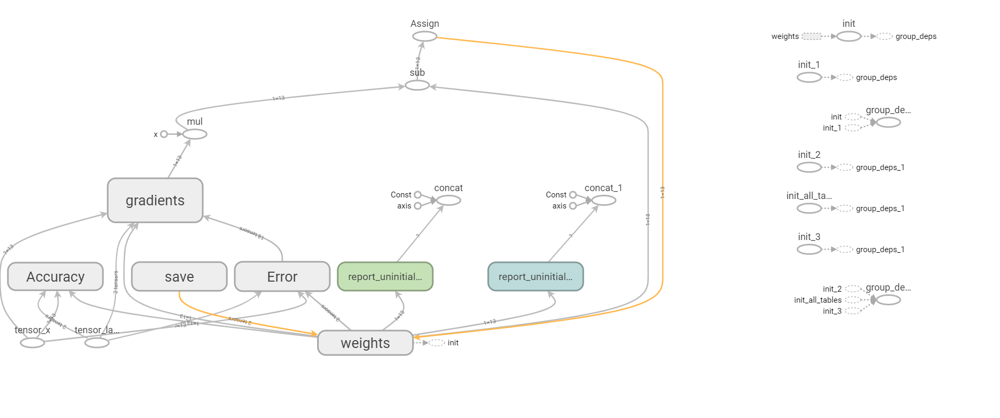

#### Gráfica de accuracy de los experimentos
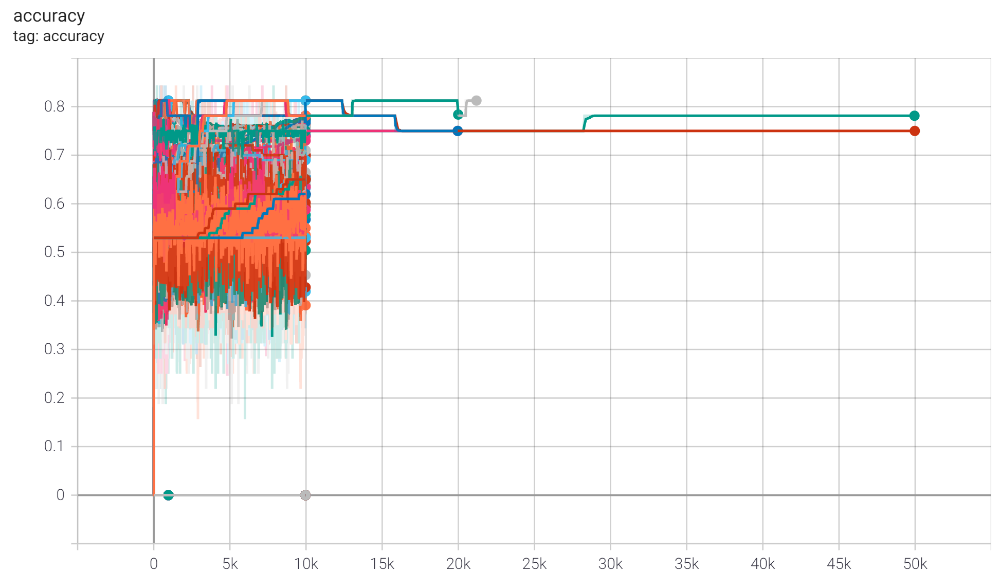

#### Gráfica de error de los experimentos
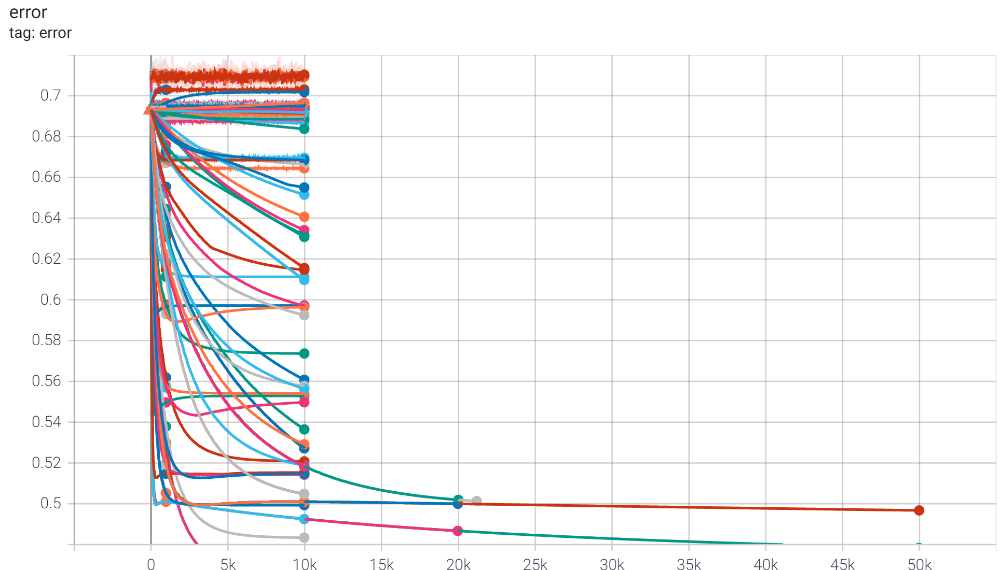

#### Captura de TensorBoard
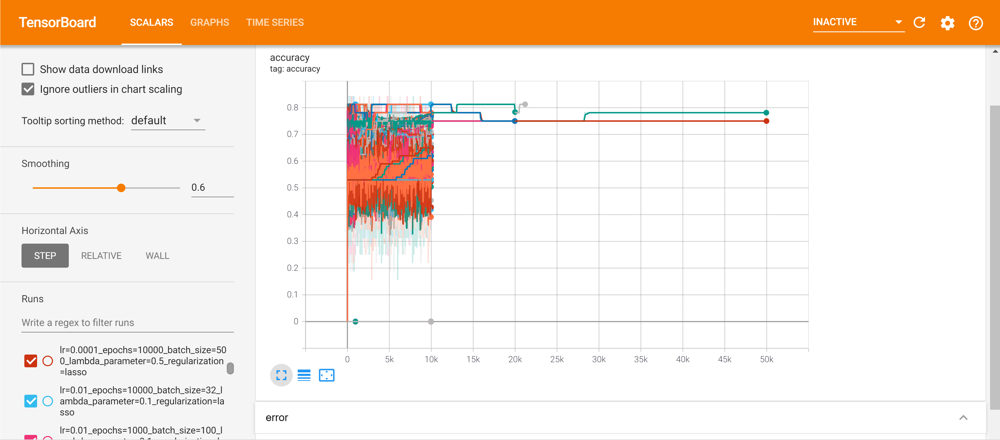

In [89]:
%load_ext tensorboard
%tensorboard --logdir='tests'

<IPython.core.display.Javascript object>

## K-fold cross validation

La validación cruzada es un procedimiento de remuestreo que se utiliza para evaluar modelos de aprendizaje automático en una muestra de datos limitada. 

El procedimiento tiene un solo parámetro llamado k que se refiere al número de grupos en los que se dividirá una muestra de datos determinada. Cuando se elige un valor específico para k, este se puede usar en lugar de k en la referencia al modelo, por ejemplo, k = 10 se convierte en una validación cruzada de 10 veces.

Por lo tanto K-fold cross validation es un método utilizado para evaluar el rendimiento de un modelo antes de realizar pruebas en datos específicos de prueba. En otras palabras, es una manera de hacer la validación del modelo planteado antes de ponerlo realmente a prueba.

El procedimiento general consiste en los siguientes pasos:

- Mezclar el conjunto de datos de forma aleatoria.
- Dividir el conjunto de datos en k grupos
- Para cada grupo único:
   - Se toma el grupo como un conjunto de datos de prueba o de reserva y se toma los grupos restantes como un conjunto de datos de entrenamiento. 
   - Se entrana un modelo con el conjunto de entrenamiento y se evalua con el conjunto de prueba.
   - Se conserva las metricas de evaluación para cada conjunto y descarta el modelo.
- Se calcula un promedio de todas las métricas de evaluación de todos los modelos generados durante el procedimiento

Las 3 tácticas más comunes para elegir un valor para k son las siguientes:

- Representativo: el valor de k se elige de manera que cada grupo de pruebas / entrenamiento de datos sea lo suficientemente grande como para ser estadísticamente representativo del conjunto de datos más amplio.
- k = 10: El valor de k se fija en 10, un valor que se ha encontrado mediante experimentación que generalmente da como resultado una estimación de la habilidad del modelo con un sesgo bajo y una varianza modesta.
- k = n: el valor de k se fija en un valor n, donde n es el tamaño del conjunto de datos para dar a cada muestra de prueba la oportunidad de ser utilizada en el conjunto de datos de reserva. Este enfoque se denomina leave-one-out cross-validation.

### Ventajas

1. Se obtienen mejores estimaciones comparadas con el proceso normal de entrenamiento de datos.
2. Balance entre bias y varianza.
3. En el método K-fold cross validation los k grupos empleados como entrenamiento son mucho menos solapantes, lo que se traduce en menor varianza al promediar las estimaciones de error.

### Desventajas

1. Su implementación es computacionalmente costosa.
2. En datasets muy grandes la capacidad de computación se incrementa y se vuelve una estrategia poco viable.
3. En datasets muy pequeños no es recomendable usar ya que no existe un numero representativo para el tamaño de k, que represente de manera correcta el dataset completo.

### Aplicaciones que se le pudieron dar en este proyecto

1. Validación de hiperparámetros para tener estimaciones más certeras.
2. Mejor estimación del rendimiento de los modelos en datos desconocidos.
3. Mejor entrenamiento de los modelos debido a la cantidad de datos, resulta que es ideal para la implementación de K-fold cross validation.

## Prueba y evaluación final

In [82]:
best_modelo_DT = train_DT(6, 6, 3, x_train, y_train, x_val, y_val, True)
best_modelo_SVM = train_SVM(8, 'poly', x_train, y_train, x_val, y_val, True)
columns = ['SibSp', 'Fare', 'passenger_sex', 'passenger_class_Middle', 'Embarked_C', 'Embarked_S']
best_modelo_NB = train_NaiveBayes(x_train[list(columns)], y_train, x_val[list(columns)], y_val, True)
best_modelo_LRS = ejecutar_modelo_LRS(0.01, 10000, x_train, y_train, 0.01, 'lasso', 500)

INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.


In [83]:
predicciones_DT = best_modelo_DT.predict(x_test)
predicciones_SVM = best_modelo_SVM.predict(x_test)
predicciones_NB = best_modelo_NB.predict(x_test)
predicciones_LRS = predict_LRS(x_test, best_modelo_LRS)[0]

INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.


In [84]:
print(predicciones_DT.shape)
print(predicciones_SVM.shape)
print(predicciones_NB.shape)
print(predicciones_LRS.shape)

(179,)
(179,)
(179,)
(179,)


In [85]:
# Agrupando todas las predicciones obtenidas por los 4 modelos
predicciones = np.stack((predicciones_DT, predicciones_SVM, predicciones_NB, predicciones_LRS))

In [86]:
# Calculando la moda para todas las predicciones obtenidas
resultado_final =  scipy.stats.mode(predicciones)[0].squeeze()

In [91]:
# Generando un dataframe con los resultados de cada prediccion
d_predicciones = {'modelo_DT': predicciones_DT, 'modelo_SVM': predicciones_SVM, 
                'modelo_NB': predicciones_NB, 'modelo_LRS': predicciones_LRS}

df_predicciones = pd.DataFrame(d_predicciones)
df_predicciones

,modelo_DT,modelo_SVM,modelo_NB,modelo_LRS
0,0,0,1,0.0
1,0,0,1,0.0
2,1,1,1,1.0
3,0,0,1,0.0
4,0,0,1,0.0
...,...,...,...,...
174,0,0,1,0.0
175,1,1,1,1.0
176,1,1,1,1.0
177,1,1,1,1.0


In [98]:
# Obteniendo las metricas de evaluacion para el resultado final del ensemble learning: 
metricas_ensemble_learning = metricas_evaluacion(y_test, resultado_final)
metricas_ensemble_learning

(0.8156424581005587,
 0.18435754189944134,
 0.8172732285635511,
 0.7974282760403205,
 0.8037867463876434)

In [99]:
df_metricas = pd.DataFrame({'values':list(metricas_ensemble_learning)}, index = ['accuracy', 'error', 'precision', 'recall', 'f1 score'])
df_metricas

,values
accuracy,0.815642
error,0.184358
precision,0.817273
recall,0.797428
f1 score,0.803787


# Conclusiones

1. Se obtiene que el modelo final empleando ensemble learning obtiene una exactitud (accuracy) del 81.56%. 
2. Todos los modelos entrenados dependen de los hiperparámetros utilizados.
3. Se observa que con valores muy grandes del parámetro de normalización (lambda) se genera underfitting y para valores muy pequeños overfitting y ciertas veces no llega a converger la función obteniendo datos NaN como resultado.
4. Algunos modelos obtuvieron mejor desempeño en las metricas de evaluación independientemente y algunos modelos tuvieron menor desempeño, pero al implementar ensemble learning esto se equilibra.

# Recomendaciones
1. Emplear grid search para obtener valores mas optimos de los hiperparámetros.
2. Al implementar el algoritmo de Naive Bayes se debe tener bien claros los conceptos estadisticos para poder realizar las funciones necesarias.
3. Realizar un análisis exploratorio con mayor profundidad.
4. Emplear más y mejores técnicas de feature engineering.
5. Emplear programación orientada a objetos para facilitar la reutilización de los modelos creados.

# Referencias

1. Brownlee, J. (2020, 2 agosto). A Gentle Introduction to k-fold Cross-Validation. Machine Learning Mastery. https://machinelearningmastery.com/k-fold-cross-validation/
2. Rodrigo, J. A. (2016). Validación de modelos predictivos (machine learning): Cross-validation, OneLeaveOut, Bootstraping. Ciencia de datos. https://www.cienciadedatos.net/documentos/30_cross-validation_oneleaveout_bootstrap